# Clustering and cell type identification (coronal section dataset)

This notebook contains code for cell type annotation of clusters for the aging coronal sections MERFISH dataset. For preprocessing of data, UMAP, and clustering please refer to `prepare_data_for_clustering.py` (this notebook utilizes the outputs of that script). This is an archival notebook.

**Associated manuscript figures/tables:**
- Figures: 1b
- Extended Data Figures: 2a,c

**Inputs required:**
- `data/integrated_aging_coronal.h5ad` - initial AnnData object of the integrated samples with Leiden clustering (generated from `prepare_data_for_clustering.py`)
- `data/integrated_aging_coronal_celltyped_regioned.h5ad` - AnnData object of annotated datasets after bad cell cluster removal and re-generation of UMAP (generated from `reUMAP.py`)

**Conda environment used**: `requirements/merfish.txt`

In [1]:
import scanpy as sc
import squidpy as sq
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
import seaborn as sns
import anndata as ad
import os
from scipy.stats import pearsonr, spearmanr

In [2]:
celltype_palette = {'Neuron-Excitatory':'forestgreen',
                    'Neuron-Inhibitory':'lightgreen', 
                    'Neuron-MSN':'yellowgreen',
                    'Astrocyte': 'royalblue', 
                    'Microglia': 'aqua', 
                    'Oligodendrocyte': 'skyblue', 
                    'OPC': 'deepskyblue',
                    'Endothelial': 'red', 
                    'Pericyte': 'darkred', 
                    'VSMC': 'salmon', 
                    'VLMC': 'indianred',
                    'Ependymal': 'gray', 
                    'Neuroblast': 'sandybrown', 
                    'NSC':'darkorange', 
                    'Macrophage':'purple', 
                    'Neutrophil':'darkviolet',
                    'T cell':'magenta', 
                    'B cell':'orchid',
}

## Preprocessing, Batch correction, UMAP, Leiden clustering -- see `prepare_data_for_clustering.py`

# Initial UMAP Plots (pre-final filtering)

Using outputs of `prepare_data_for_clustering.py`

Below we show the initial UMAP plots and Leiden clustering that was used to help annotate cell types. UMAP plots of cells are colored by age group (binary old young), volume, batch, volume, transcript count, Leiden cluster, etc. A cluster with low transcript count and low segmentation volume was difficult to annotate and corresponding to segmentations of poly T beads in the MERFISH dataset. This cluster was removed in the final dataset.

In [3]:
# read in data with clusters

fn = "data/integrated_aging_coronal.h5ad"
adata = sc.read_h5ad(fn.split(".")[0]+"_bbknn_umap_leiden1.h5ad")

/home/edsun/.conda/envs/merfish/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


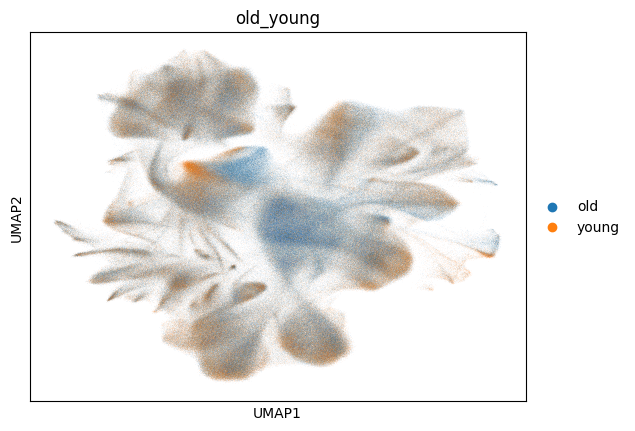

In [4]:
# UMAP with age

adata.obs['old_young'] = ['young' if age<17 else 'old' for age in adata.obs['age']]

sc.pl.umap(adata, color="old_young", show=False)
plt.show()

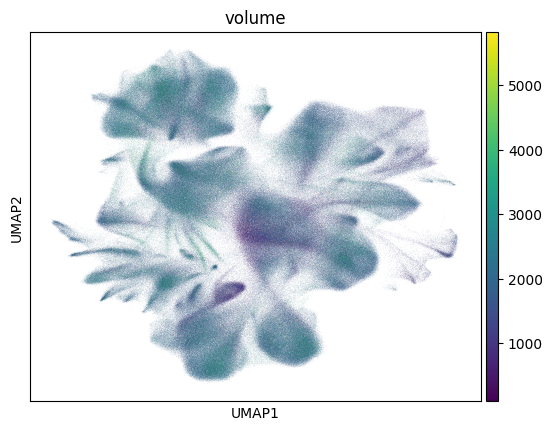

In [5]:
# UMAP with volume

sc.pl.umap(adata, color="volume", show=False)
plt.show()

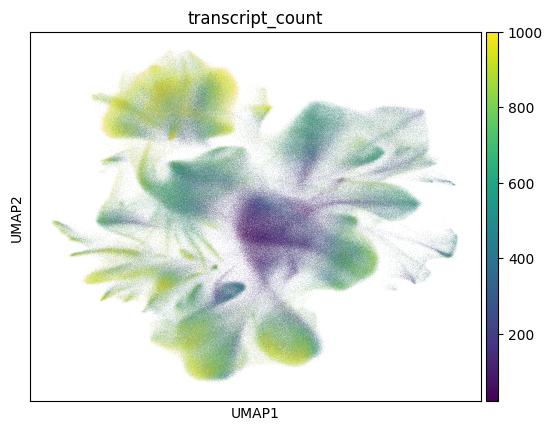

In [4]:
sc.pl.umap(adata, color="transcript_count", show=False, vmax=1000)
plt.show()

/home/edsun/.conda/envs/merfish/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


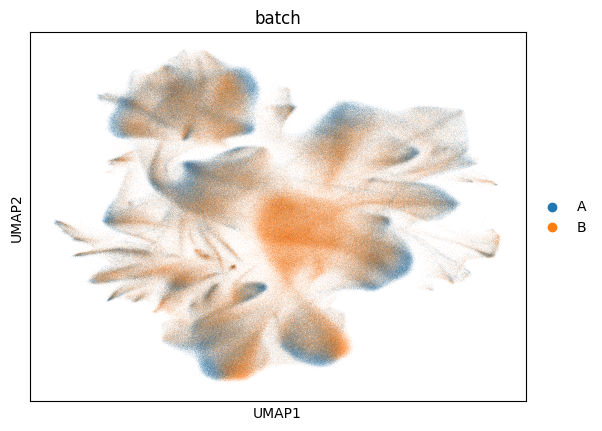

In [9]:
# UMAP with batch

sc.pl.umap(adata, color="batch", show=False)
plt.show()

/home/edsun/.conda/envs/merfish/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


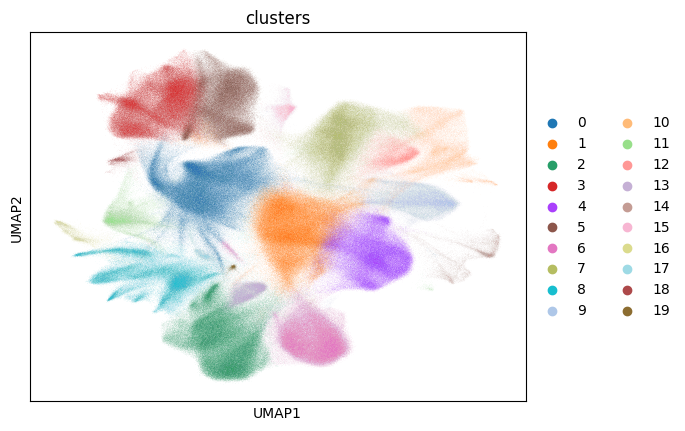

In [6]:
# UMAP with clusters

sc.pl.umap(adata, color="clusters", show=False)
plt.show()

Batch-specific low-volume cells were removed from the dataset in downstream analysis (this is Cluster 1).

# Cell type identification from marker genes

Using outputs of `prepare_data_for_clustering.py`.

In the MERFISH panel, we included a set of markers for each cell type (based on literature review, previous datasets, single-cell RNAseq datasets in specific brain regions, etc). We used a subset of these markers (see Supplementary Tables of manuscript for each subset used) that localized to independent cell clusters to annotate the cell types. This was performed by visualizing the Leiden clusters using UMAP and later via confirmation by clustered heatmaps. We performed successive rounds of Leiden clustering and annotation until all cell types were confidently identified.

First, we start with the initial Leiden clustering:

In [3]:
# read in data with clusters

fn = "data/integrated_aging_coronal.h5ad"
adata = sc.read_h5ad(fn.split(".")[0]+"_bbknn_umap_leiden1.h5ad")

In [3]:
# Major cell type markers (not all cell types are expected to be identified)

major_celltype_markers_dict = {
    "Neuron":["Dpp6", "Reln"],
    "Excitatory Neuron":["Slc17a7", "Slc17a6"],
    "Inhibitory Neuron":["Slc32a1", "Gad1", "Gad2"],
    "MSN":["Drd1", "Drd2", "Adora2a"],
    "Other_Neuron":["Chat","Slc6a3","Th","Tph2"],
    "Astrocyte":["Aqp4", "Gfap", "Aldh1l1"],
    "Microglia":["Cx3cr1", "C1ql3", "Csf1r","Ccl4","C1qa","C1qb","Hexb"],
    "Oligodendrocyte":["Olig1", "Olig2", "Opalin", "Mog", "Klk6", "Cldn11"],
    "OPC":["Pdgfra", "Vcan"],
    "New_Olig":["Gpr17","Bmp4"],
    "Endothelial":["Flt1","Cldn5","Apold1","Ly6c1"],
    "LEC":["Flt4","Prox1","Pecam1","Pdpn"],
    "Hemoglobin-expressing vascular cells":["Alas2"],
    "VSMC":["Acta2"],
    "VLMC":["Slc6a13"],
    "Pericyte":["Kcnj8", "Vtn", "Ifitm1"],
    "Ependymal":["Ccdc153", "Rarres2", "Tmem212"],
    "qNSC":["Prom1", "Slc1a3", "Nr2e1", "Sox9", "Vcam1", "Hes5", "Cd9", "Thbs4", "Gja1"],
    "aNSC/NPC":["Pclaf", "H2afx", "Rrm2", "Insm1", "Egfr", "Mki67", "Mcm2", "Cdk1"],
    "Neuroblast":["Stmn2", "Dlx6os1", "Igfbpl1", "Dcx", "Cd24a", "Tubb3", "Sox11", "Dlx1"],
    "Macrophage":["Mrc1", "Pf4", "Lyz2"],
    "T cell":["Cd3e","Nkg7","Ccl5","Ms4a4b","Cd3g","Cd69","Lat"],
    "T cell (cytotoxic)":["Cd8a","Cd8b1","Gzmb","Trac"],
    "T cell (helper)":["Cd4","Ccr4","Cd28"],
    "T cell (reg)":["Ikzf2","Foxp3"],
    "T cell (tissue retention)":["Itga1","Itga4","Sell","Cd69"],
    "NK cell":["Klrd1","Klrk1","Fcgr3"],
    "B cell":["Cd79a","Cd19","Ighm","Ighd","Cd27"],
    "B cell (memory)":["Cd40"],
    "B cell (effector/plasma)":["Ly6c2","Sdc1","Ms4a1"],
    "Monocyte":["Plac8", "Ly6c1", "Cx3cr1"], # last two are for inflammatory and resident respectively
    "Dendritic cell":["Cd209a", "Flt3"],
    "Neutrophil":["S100a9","Ptprc","Itgam","Cxcr2"],
    "Mast cell":["Hdc", "Cma1"],
    "Dividing":["Top2a","Mki67","Egfr"],
}

Neuron


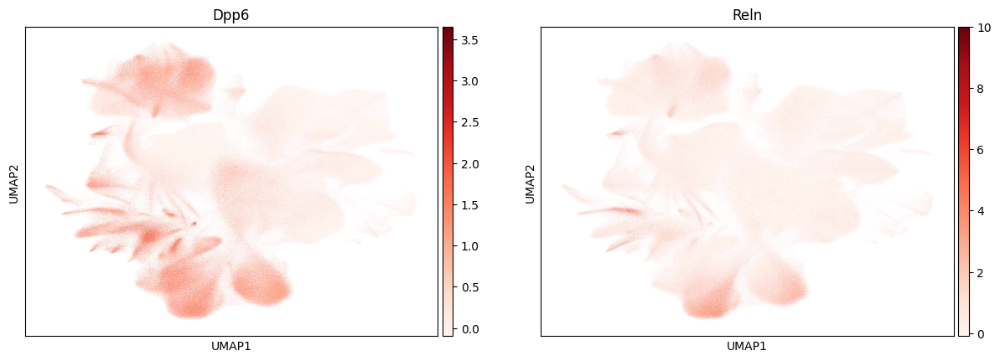

Excitatory Neuron


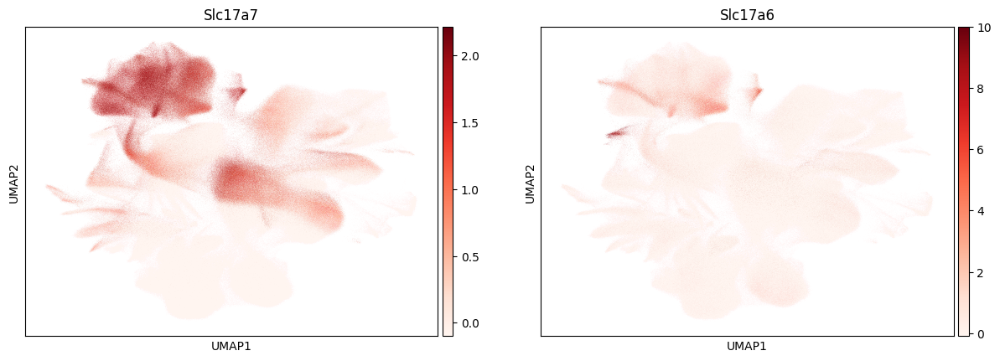

Inhibitory Neuron


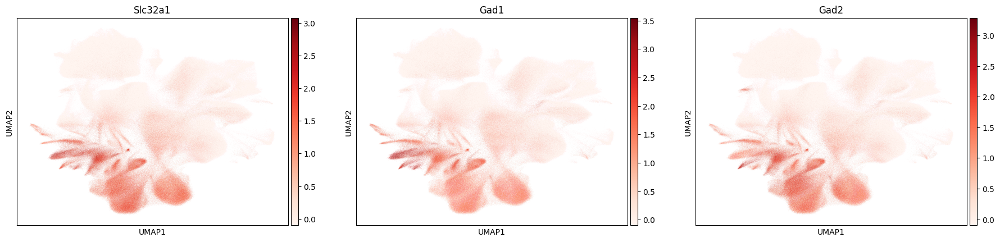

MSN


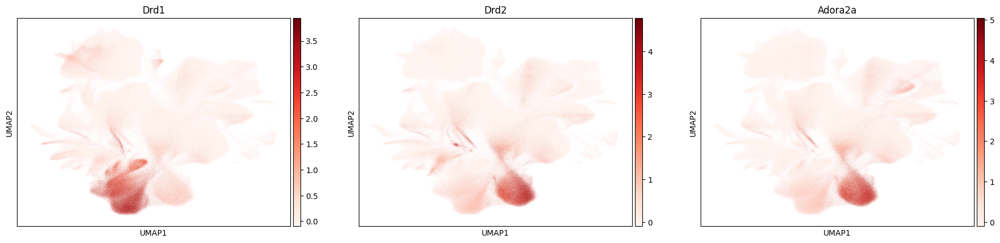

Other_Neuron


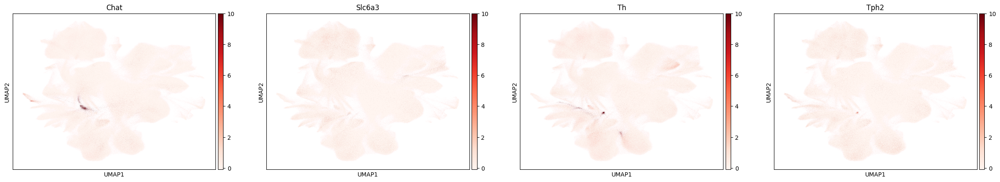

Astrocyte


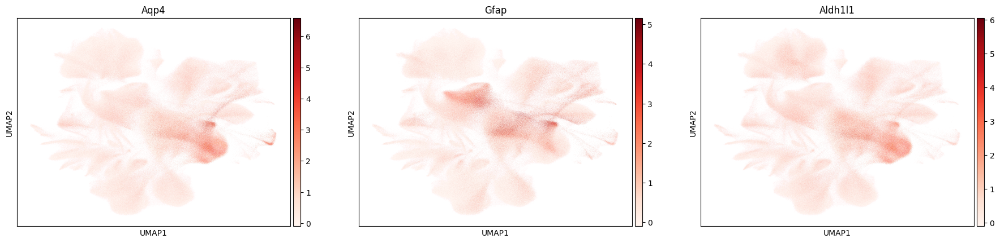

Microglia


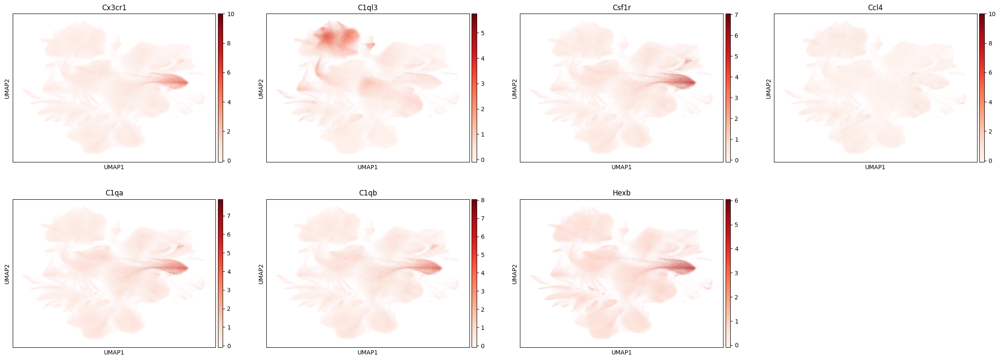

Oligodendrocyte


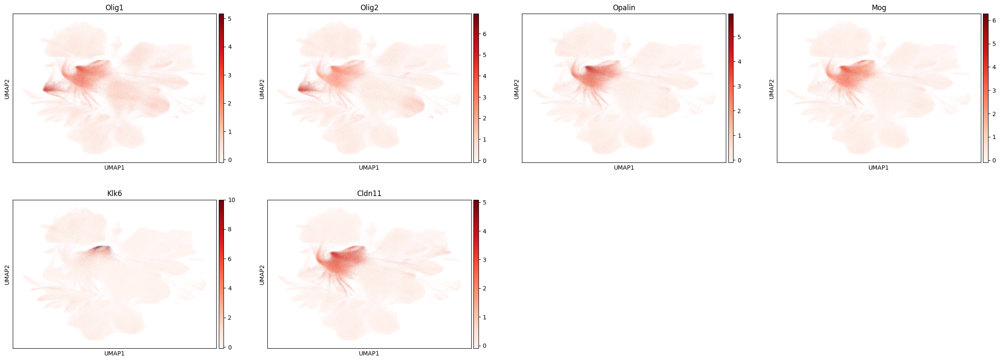

OPC


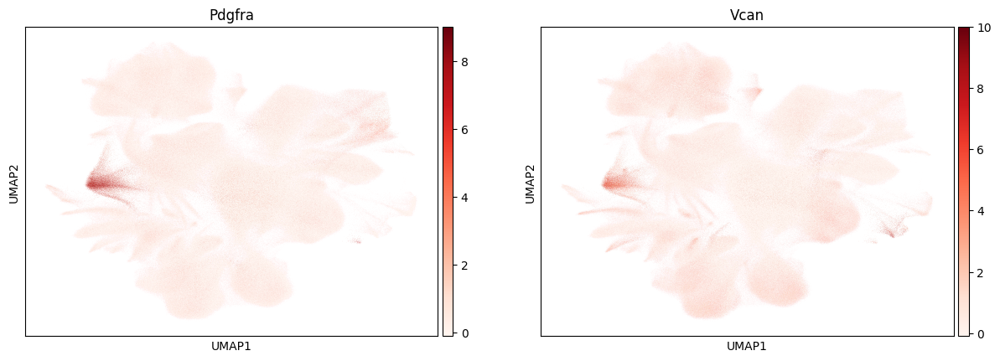

New_Olig


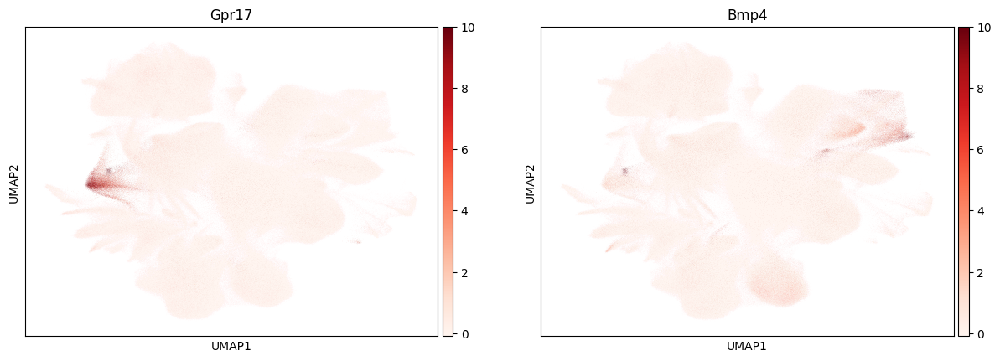

Endothelial


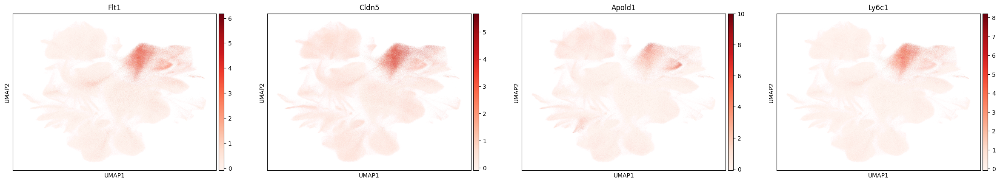

LEC


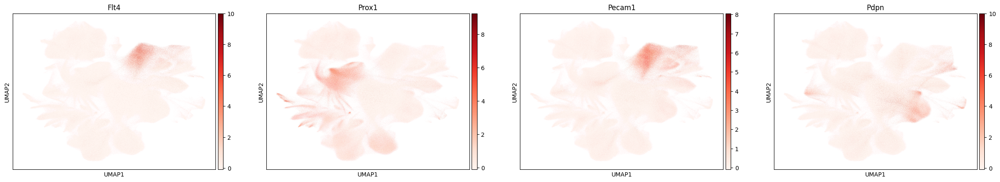

Hemoglobin-expressing vascular cells


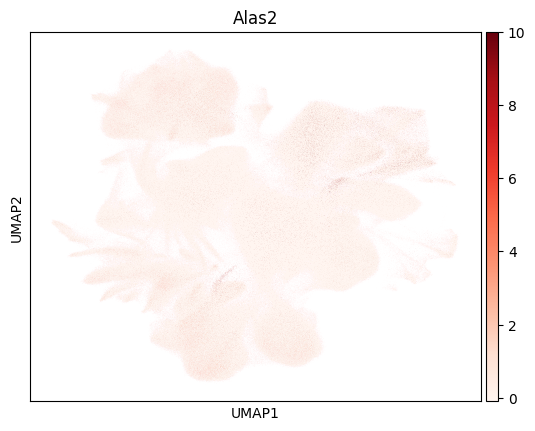

VSMC


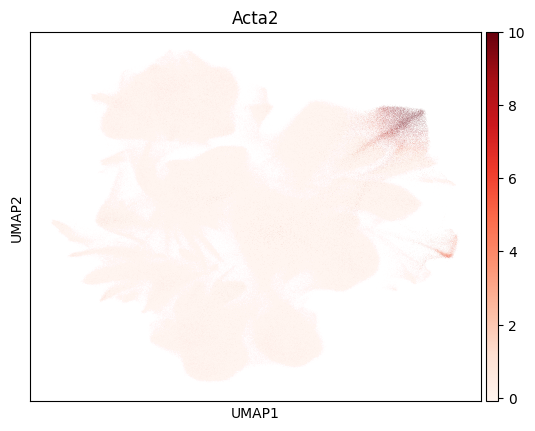

VLMC


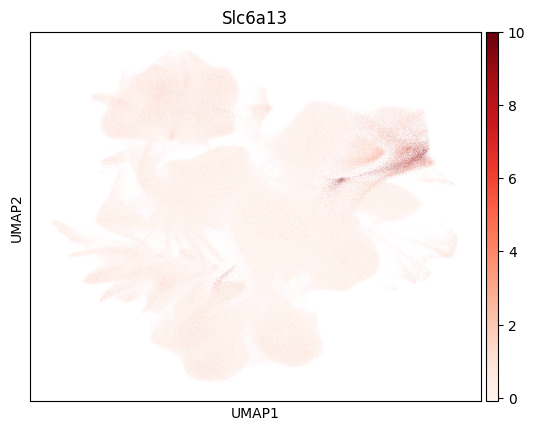

Pericyte


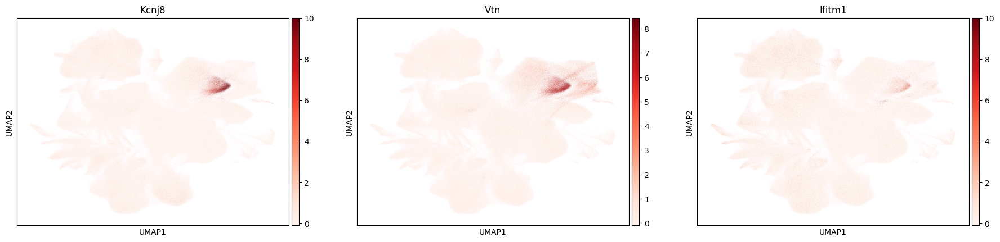

Ependymal


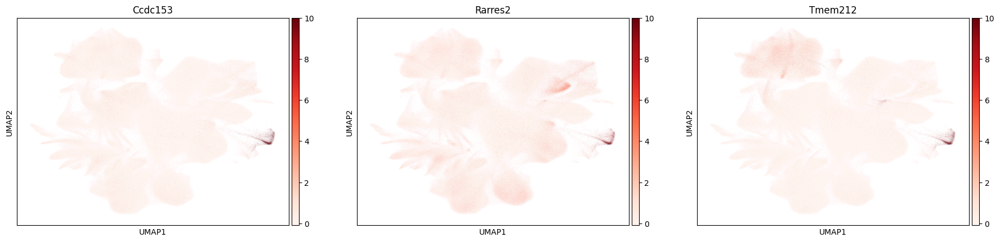

qNSC


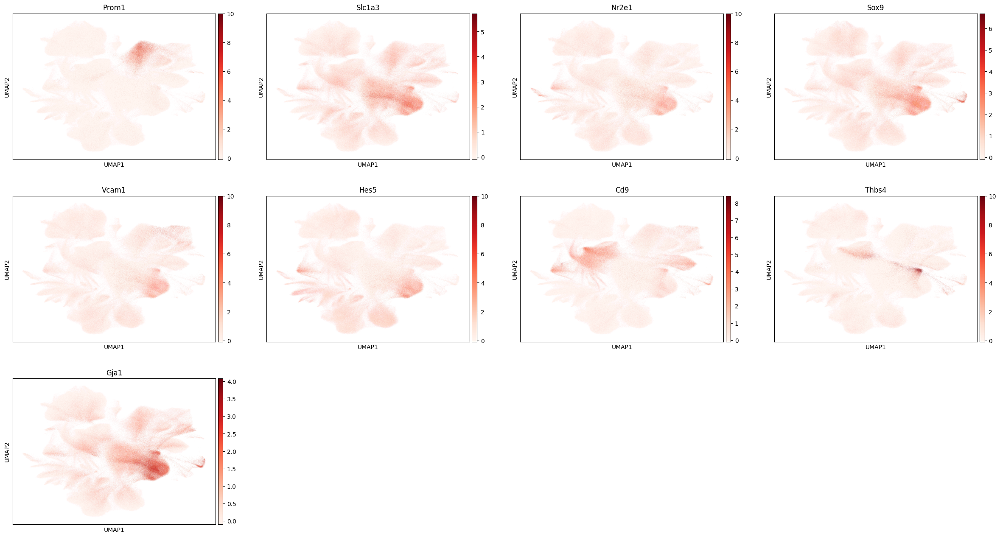

aNSC/NPC


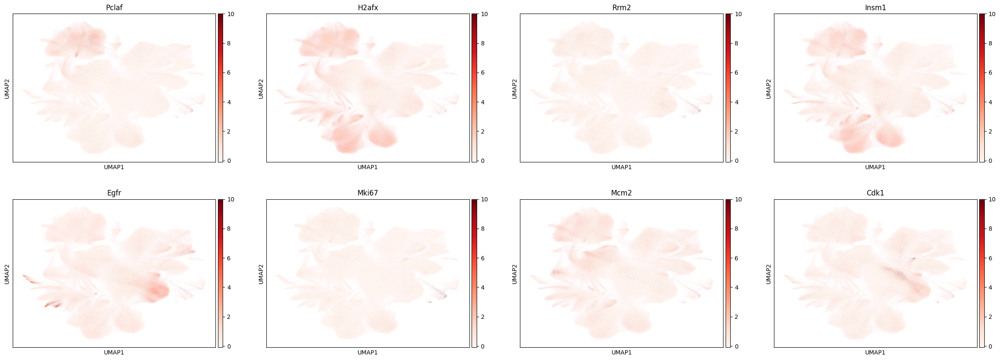

Neuroblast


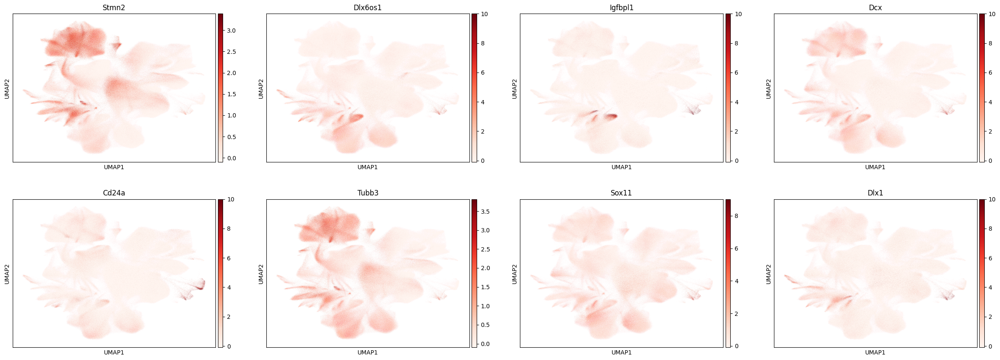

Macrophage


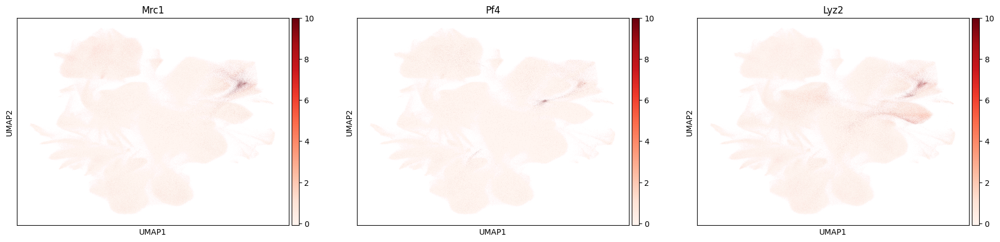

T cell


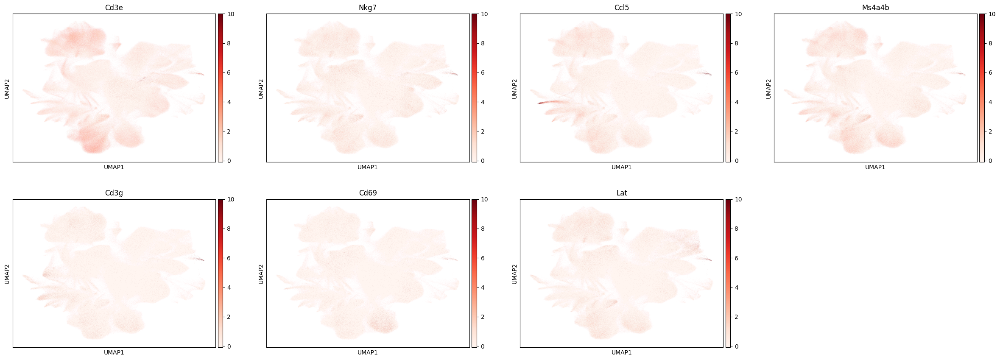

T cell (cytotoxic)


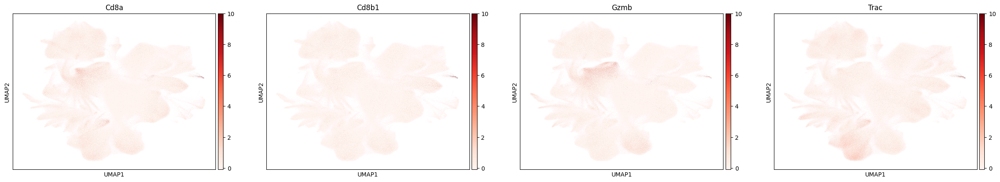

T cell (helper)


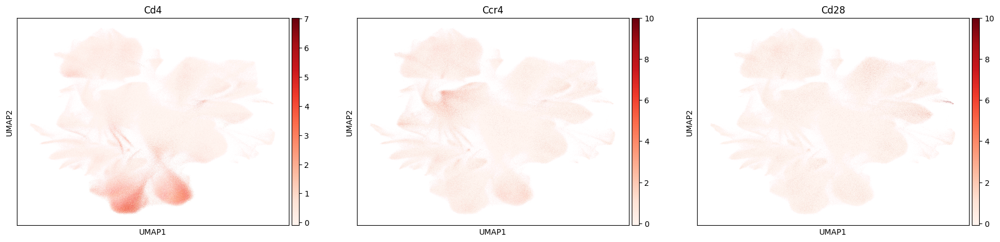

T cell (reg)


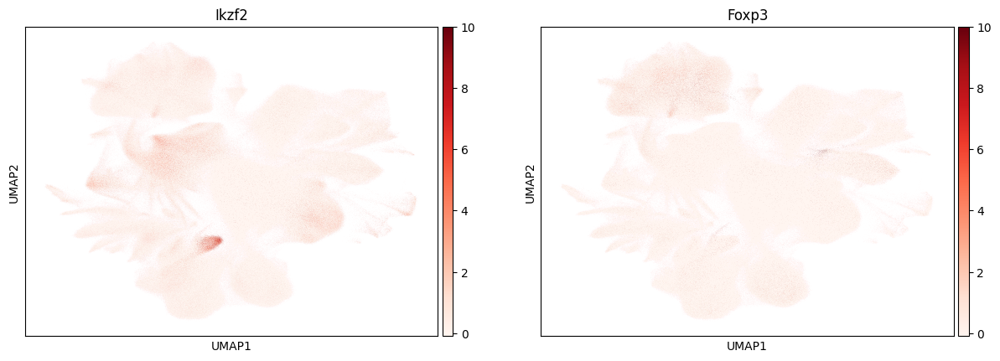

T cell (tissue retention)


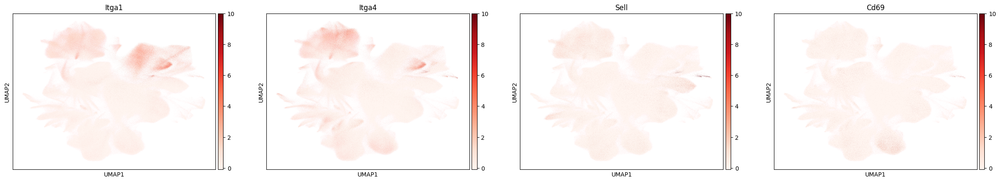

NK cell


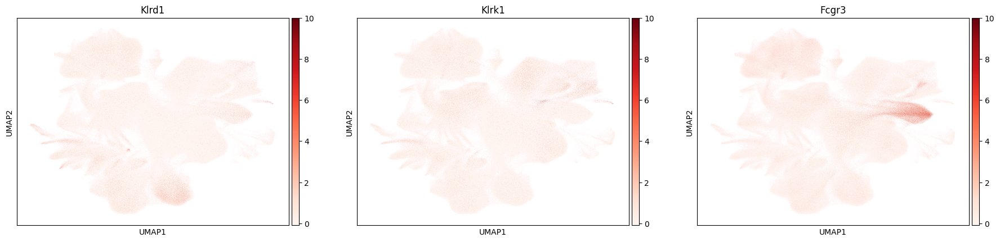

B cell


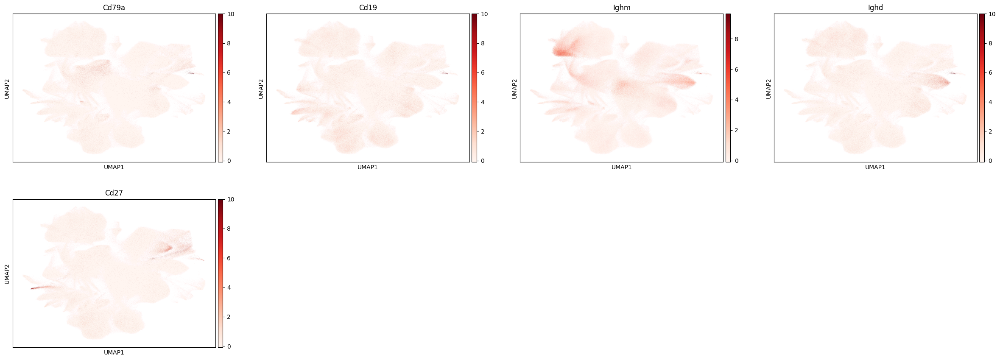

B cell (memory)


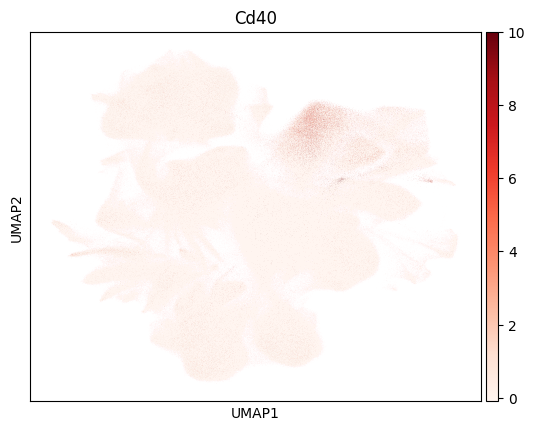

B cell (effector/plasma)


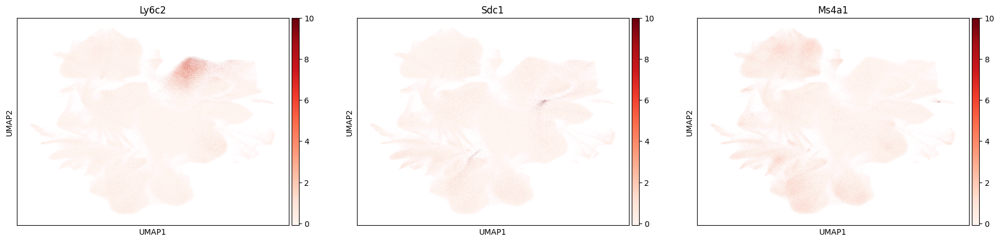

Monocyte


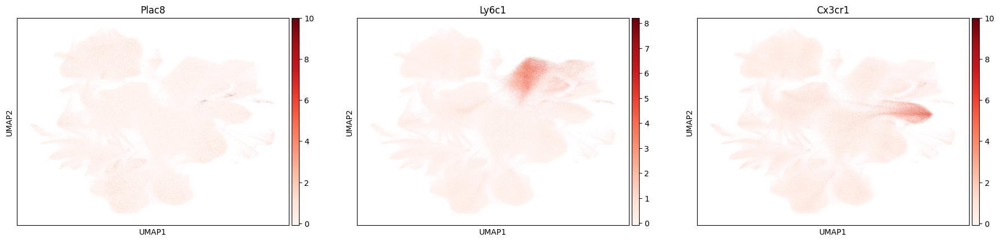

Dendritic cell


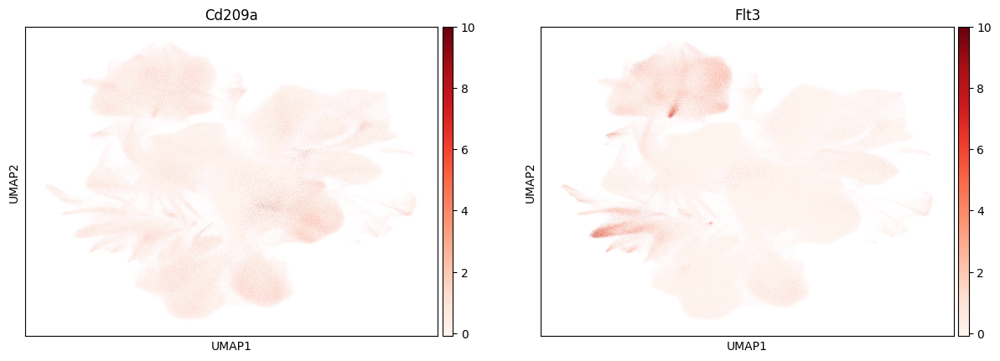

Neutrophil


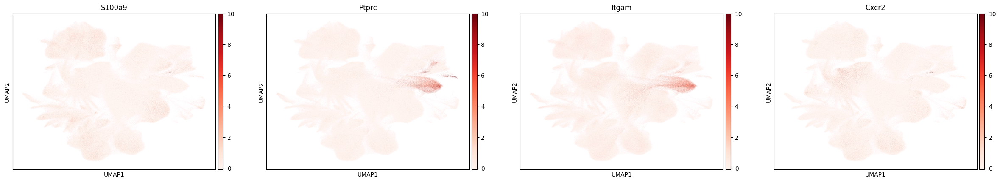

Mast cell


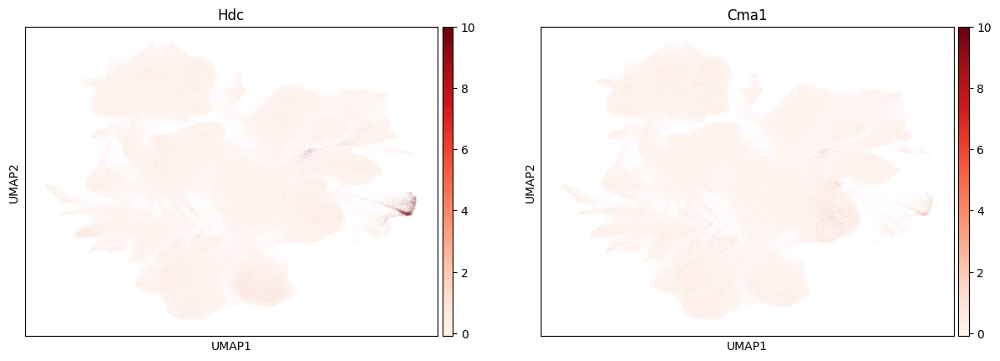

Dividing


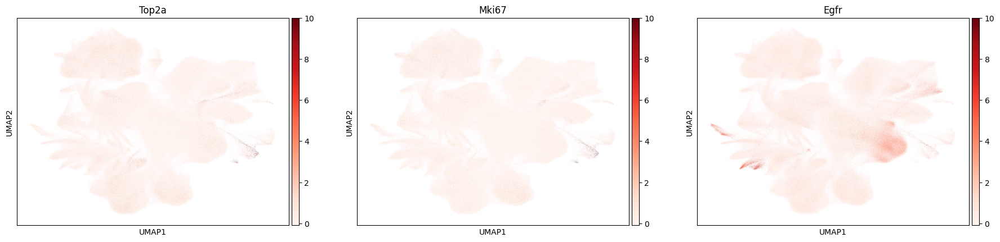

In [8]:
# Visualization of marker expression across UMAP

for key in major_celltype_markers_dict.keys():
    print(key)
    sc.pl.umap(adata, color=major_celltype_markers_dict[key], cmap='Reds', vmin=-0.1)

Based on the UMAP and heatmap visualizations for different clusters, we make the following annotations based on if there was higher expression of a subset of cell type markers in each cluster. For clusters that could potentially be labeled for multiple cell types or contained potential subsets of cell types, we will perform addition Leiden clustering.

In [5]:
# Annotations for each initial cluster

leiden_05_mapping = {
    '0': 'Oligodendrocyte',
    '1': 'Astrocyte', # low-volume, batch-specific --> REMOVED
    '2': 'Neuron-Inhibitory',
    '3': 'Neuron-Excitatory',
    '4': 'Astrocyte',
    '5': 'Neuron-Excitatory',
    '6': 'Neuron-MSN',
    '7': 'Endothelial',
    '8': 'Neuron-Inhibitory',
    '9': 'Microglia',
    '10': 'VSMC/VLMC/Macrophage/T cell/B cell/Neutrophil',
    '11': 'OPC',
    '12': 'Pericyte',
    '13': 'Neuron-Inhibitory',
    '14': 'Ependymal/NSC/Neuroblast',
    '15': 'Neuron-Excitatory',
    '16': 'Neuron-Inhibitory',
    '17': 'Neuron-Inhibitory',
    '18': 'Neuron-Excitatory',
    '19': 'Neuron-Inhibitory',
}

In [6]:
# set cell type annotations to adata.obs.celltype

adata.obs['celltype'] = [leiden_05_mapping[i] for i in adata.obs['clusters']]

/home/edsun/.conda/envs/merfish/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


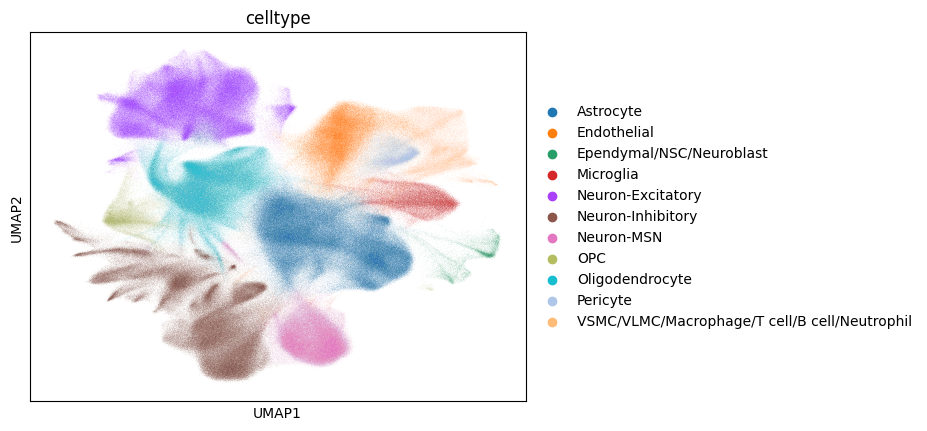

In [9]:
# UMAP colored by initial cell types

sc.pl.umap(adata, color="celltype", show=False)
plt.savefig("plots/clustering/umap_integrated_coronal_bbknn_celltype.png", bbox_inches="tight", dpi=300)
plt.show()

In [10]:
# # save intermediate
# adata.write_h5ad(fn.split(".")[0]+"_firstclustered.h5ad")

## Sub-cluster ambiguous clusters further

After making the initial round of cell type annotations, there were a few Leiden clusters that could be annotated for multiple cell types (generally rare cell types). To further resolve these clusters, we performed sub-clustering on cells in the target cluster and re-visualized UMAPs and heatmaps to annotate the subclusters based on cell type marker expression.

For this, we used the `recluster_subset()` function below and manually iterated over different resolution settings for proper subclustering of each ambiguous cell cluster.

In [4]:
def recluster_subset(sub_adata, resolution=0.1, n_pcs=20, n_neighbors=15):
    '''
    Runs clustering (pca -> neighbors -> leiden + umap) on sub_adata
    '''
    sc.tl.pca(sub_adata)
    sc.pp.neighbors(sub_adata, n_pcs=n_pcs, n_neighbors=n_neighbors)
    sc.tl.umap(sub_adata)
    sc.tl.leiden(sub_adata, key_added="leiden", resolution=resolution)

In [6]:
# # read in intermediate data
# fn = "data/integrated_aging_coronal.h5ad"
# adata = sc.read_h5ad(fn.split(".")[0]+"_firstclustered.h5ad")

In [7]:
# initialize array for finer resolution cell type annotations
celltype_fineres = adata.obs["celltype"].values.astype(str)

### VSMC/VLMC/Macrophage/T cell/B cell/Neutrophil

In [8]:
celltype_to_subcluster='VSMC/VLMC/Macrophage/T cell/B cell/Neutrophil'
sub_adata = adata[adata.obs['celltype']==celltype_to_subcluster]

In [11]:
recluster_subset(sub_adata, resolution=0.25)

/home/edsun/.conda/envs/merfish/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


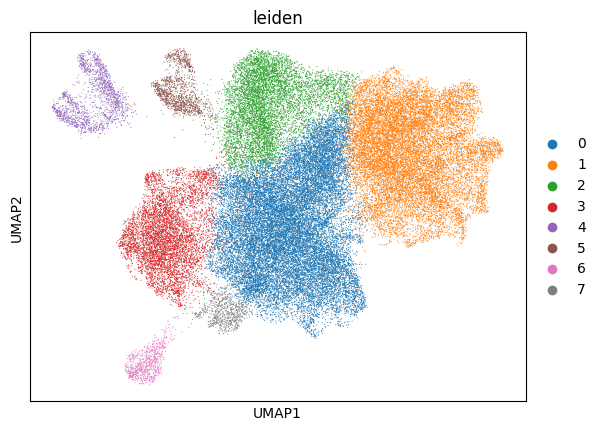

VSMC


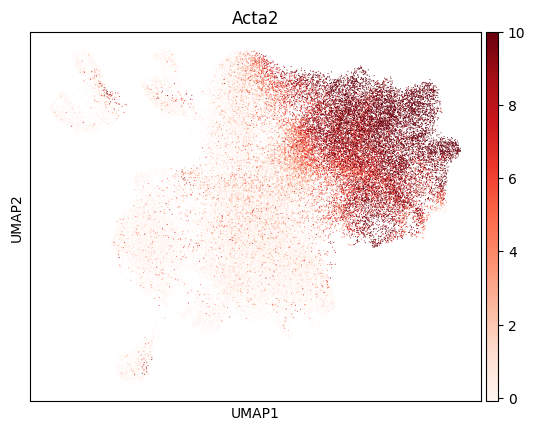

VLMC


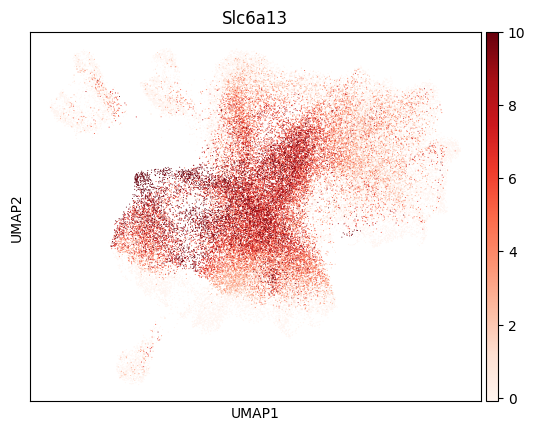

Macrophage


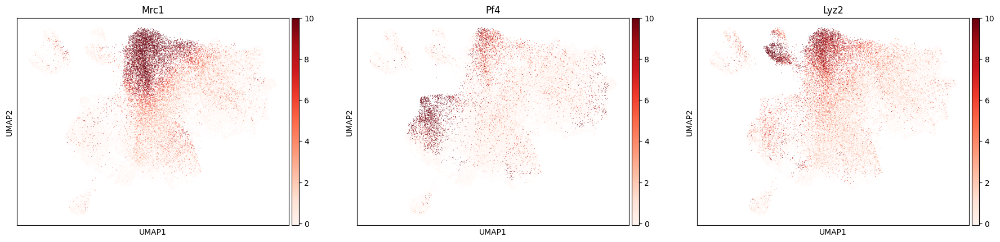

T cell


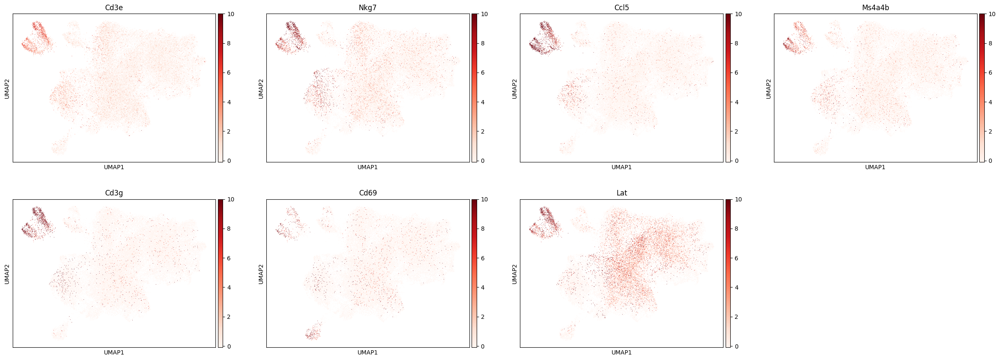

B cell


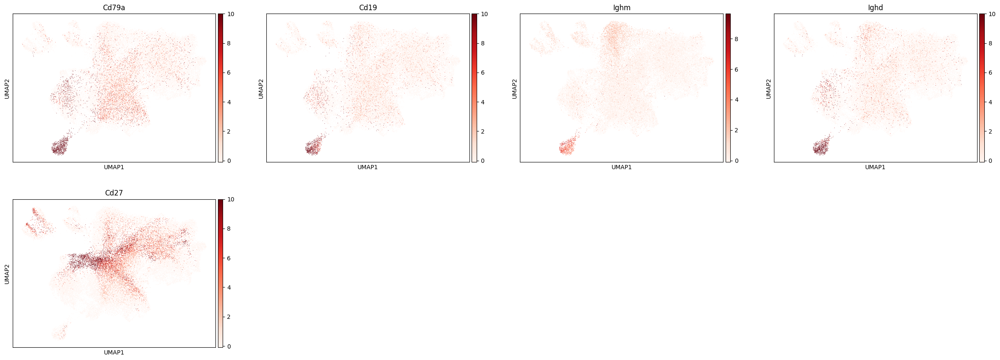

Neutrophil


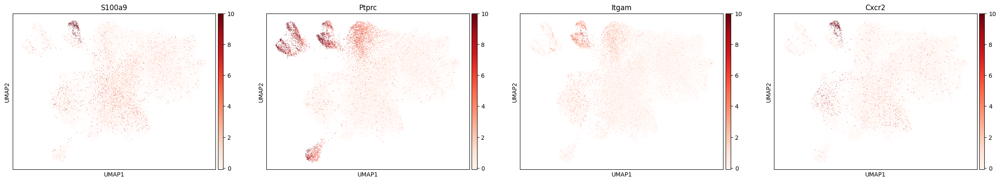

LEC


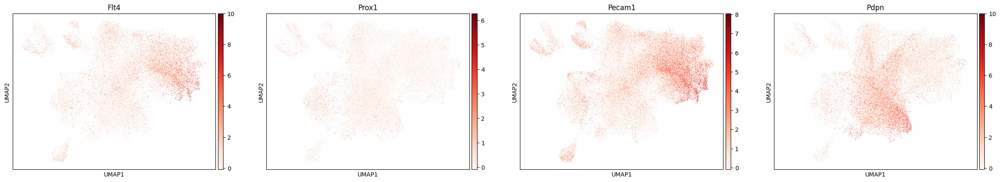

Hemoglobin-expressing vascular cells


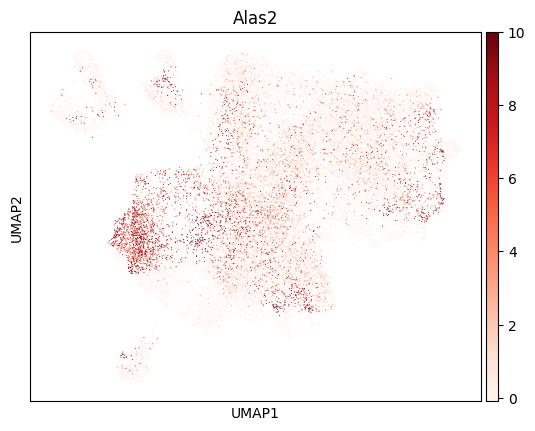

Pericyte


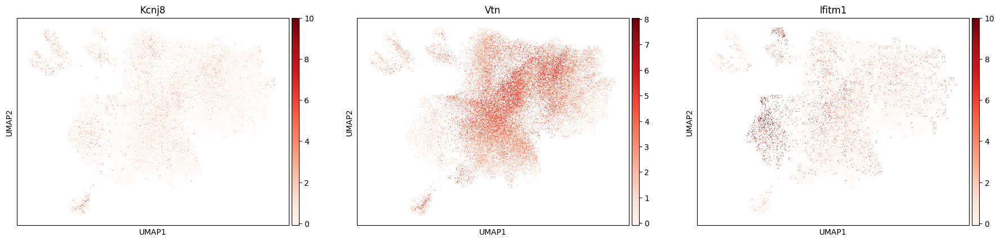

Endothelial


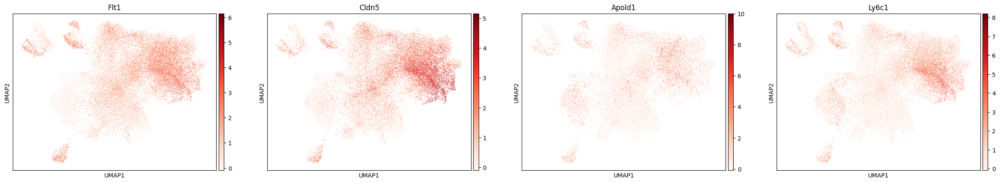

Dendritic cell


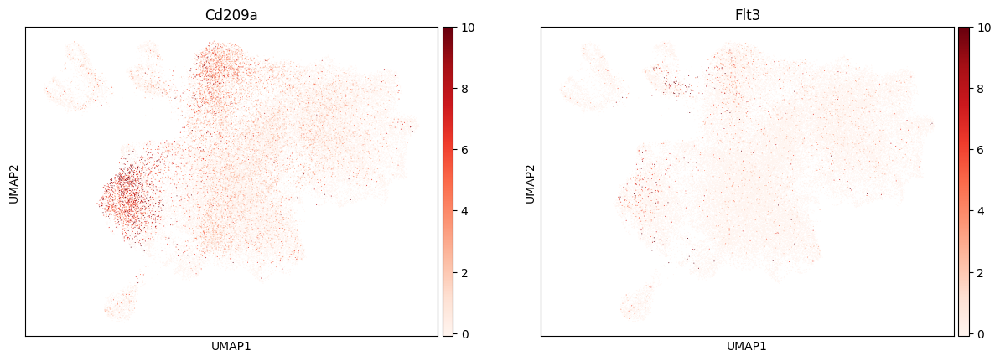

Mast cell


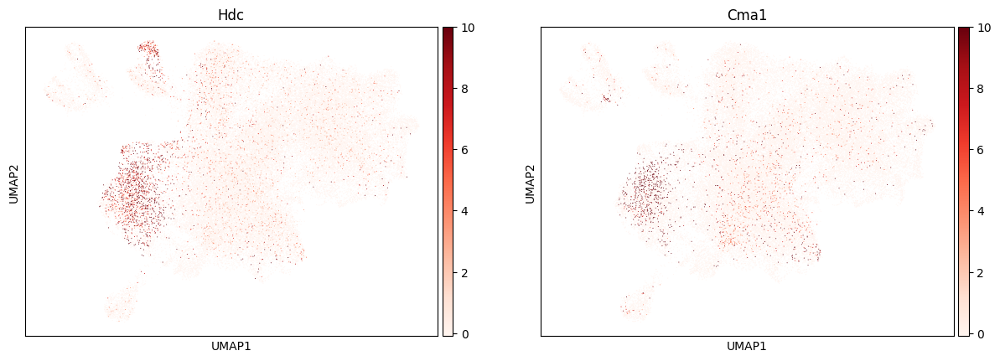

Monocyte


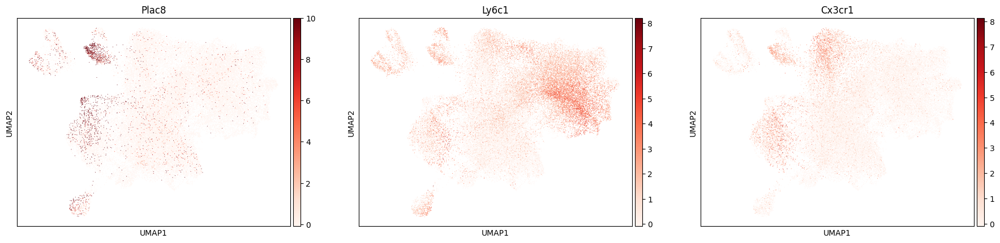

In [12]:
# plot clusters and key marker genes on UMAP

sc.pl.umap(sub_adata, color='leiden', cmap='Reds', vmin=-0.1)
for key in ["VSMC", "VLMC", "Macrophage", "T cell", "B cell", "Neutrophil",
            "LEC", "Hemoglobin-expressing vascular cells", "Pericyte", "Endothelial",
            "Dendritic cell", "Mast cell", "Monocyte"]:
    print(key)
    sc.pl.umap(sub_adata, color=major_celltype_markers_dict[key], cmap='Reds', vmin=-0.1)

Based on UMAP and heatmap visualizations of marker expression within the new sub-clusters, we are now able to confidently annotate each of the cell types (VLMC, VSMC, Macrophage, T cell, Neutrophil, B cell).

In [22]:
# cell type annotation

mapping_subclusters = {
    '0': "VLMC",
    '1': "VSMC",
    '2': "Macrophage",
    '3': "VLMC",
    '4': "T cell",
    '5': "Neutrophil",
    '6': "B cell",
    '7': "VLMC",
}

In [23]:
# add new annotations

celltype_fineres[adata.obs["celltype"]==celltype_to_subcluster] = [mapping_subclusters[i] for i in sub_adata.obs['leiden']]

### Ependymal/NSC/Neuroblast

In [24]:
celltype_to_subcluster='Ependymal/NSC/Neuroblast'
sub_adata = adata[adata.obs['celltype']==celltype_to_subcluster]

In [25]:
recluster_subset(sub_adata, resolution=0.2)

/home/edsun/.conda/envs/merfish/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:229: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata.obsm['X_pca'] = X_pca


/home/edsun/.conda/envs/merfish/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


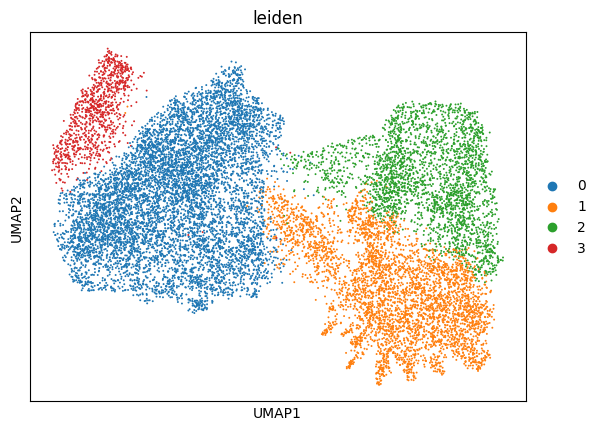

Ependymal


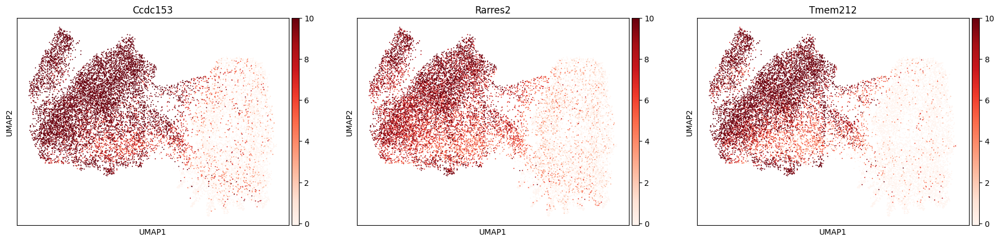

qNSC


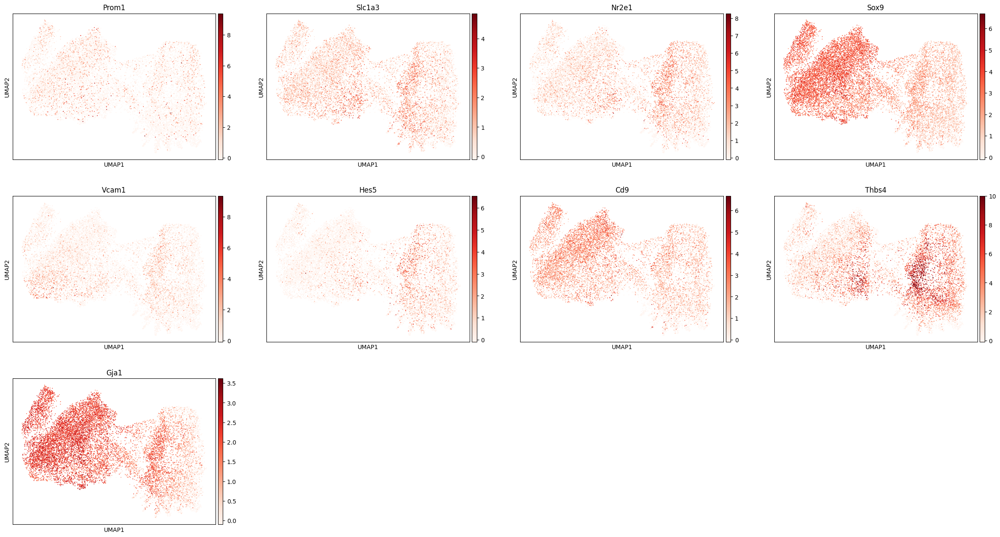

aNSC/NPC


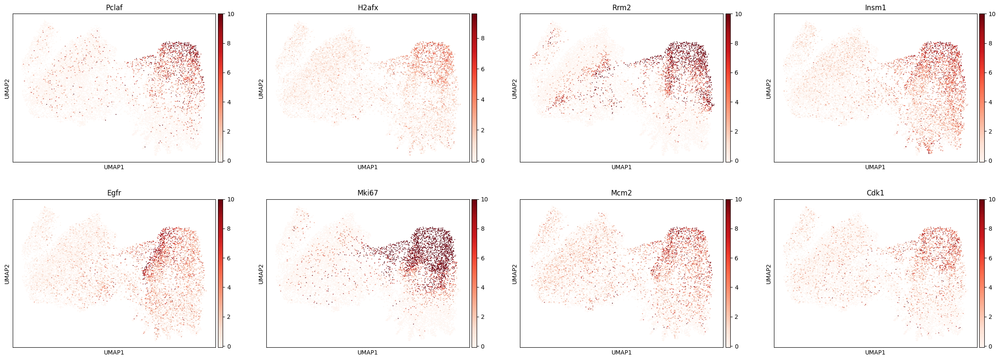

Neuroblast


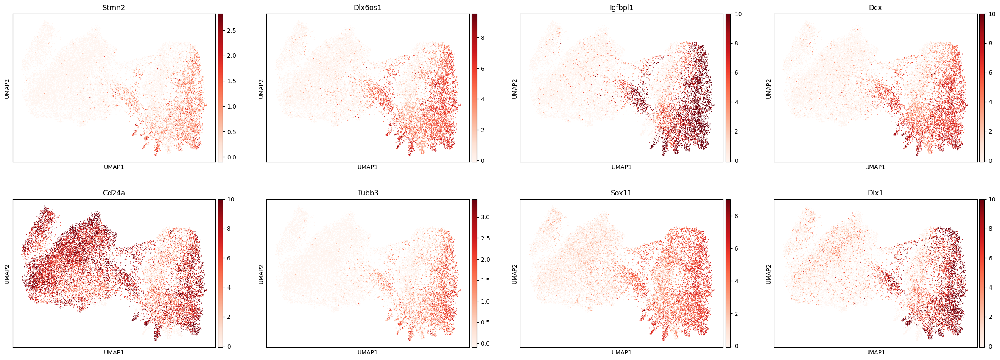

In [26]:
# plot clusters and key marker genes on UMAP

sc.pl.umap(sub_adata, color='leiden', cmap='Reds', vmin=-0.1)
for key in ["Ependymal", "qNSC", "aNSC/NPC", "Neuroblast"]:
    print(key)
    sc.pl.umap(sub_adata, color=major_celltype_markers_dict[key], cmap='Reds', vmin=-0.1)

Based on UMAP and heatmap visualizations of marker expression within the new sub-clusters, we are now able to confidently annotate each of the cell types (Ependymal, NSC, Neuroblast).

In [27]:
# cell type annotation

mapping_subclusters = {
    '0': "Ependymal",
    '1': "Neuroblast",
    '2': "NSC",
    '3': "Ependymal",
}

In [28]:
# add new annotations

celltype_fineres[adata.obs["celltype"]==celltype_to_subcluster] = [mapping_subclusters[i] for i in sub_adata.obs['leiden']]

## Save final cell type identities

Now that we have fully annotated the cell type clusters, we map the appropriate labels and color palette into the metadata for downstream analysis.

We also update the metadata for the AnnData object containing the raw counts (since our clustering use scaled normalized expression).

In [29]:
# update cell type labels in adata
adata.obs['celltype'] = celltype_fineres

In [5]:
# order cell types
categories_order = ['Neuron-Excitatory', 'Neuron-Inhibitory', 'Neuron-MSN',
                    'Astrocyte', 'Microglia', 'Oligodendrocyte', 'OPC',
                    'Endothelial', 'Pericyte', 'VSMC', 'VLMC',
                    'Ependymal', 'Neuroblast', 'NSC', 
                    'Macrophage', 'Neutrophil','T cell', 'B cell']
adata.obs['celltype'] = adata.obs['celltype'].astype('category').cat.reorder_categories(categories_order)

# update colors of cell types
adata.uns['celltype_colors'] = [celltype_palette[x] for x in categories_order]

# save
adata.write_h5ad("data/integrated_aging_coronal_clustered.h5ad")

In [6]:
# update raw data
fn = "data/integrated_aging_coronal.h5ad"
raw_adata = sc.read_h5ad(fn.split(".")[0]+"_raw.h5ad")

# save raw counts too
raw_adata.obs = adata.obs
raw_adata.var = adata.var
raw_adata.obsm = adata.obsm
raw_adata.varm = adata.varm
raw_adata.obsp = adata.obsp
raw_adata.varp = adata.varp
raw_adata.uns = adata.uns

raw_adata.write_h5ad("data/integrated_aging_coronal_clustered_raw.h5ad")

# Make final plots

After removing the false segmentation cluster consisting of low volume/transcript counts, we performed a final UMAP visualization (see `reUMAP.py`) for the dataset, which is shown below.

Additionally, the spatial nature of the dataset allows us to confirm the validity of the cell type annotations made above by visualizing them spatially to determine if known spatial localizations of different cell types are recovered. They appear to be quite accurate (oligodendrocytes + OPCs in white matter regions, VLMCs in the meninges, excitatory neurons in cortex, inhibitory neurons in striatum and adjacent regions, NSCs and neuroblasts in known neurogenic niches, etc)

### Coronal aging UMAP

In [7]:
adata = sc.read_h5ad("data/integrated_aging_coronal_clustered.h5ad")
adata = adata[(adata.obs.clusters!="1")&(adata.obs.mouse_id!="89")&(adata.obs.mouse_id!="67")].copy() # exclude bad cluster and slide

In [ ]:
# re-ran UMAP with cell subset for this visualization

fig, ax = plt.subplots(1, 1, figsize=(5,5))
sc.set_figure_params(dpi=500)

sc.pl.umap(adata, color="celltype", show=False, ax=ax, legend_fontsize=18)
plt.xlabel("UMAP 1", fontsize=18)
plt.ylabel("UMAP 2", fontsize=18)
plt.title("Cell type", fontsize=18)
plt.savefig("plots/clustering/umap_integrated_coronal_bbknn_FINAL.pdf", bbox_inches="tight")
plt.show()

## Spatial plots of cell types

In [11]:
# read in rotated/aligned data
adata = sc.read_h5ad("data/integrated_aging_coronal_celltyped_regioned.h5ad")
adata = adata[(adata.obs.clusters!="1")&(adata.obs.mouse_id!="89")&(adata.obs.mouse_id!="67")].copy() # exclude bad cluster and slide

In [ ]:
age = 6.6 # 9.8, 6.6, 23.5, 34.5

fig, ax = plt.subplots(1, 1, figsize=(6,5))
sc.set_figure_params(dpi=500)

curr_adata = adata[adata.obs.age==age].copy()
sc.pl.embedding(curr_adata, "spatial", color="celltype", s=3, show=False,
               ax=ax, legend_fontsize=18)
plt.xlabel("Spatial 1", fontsize=16)
plt.ylabel("Spatial 2", fontsize=16)
plt.title(f"{str(age)} months old", fontsize=18)
plt.axis('off')
plt.savefig("plots/clustering/spatial_celltype_young.pdf", bbox_inches='tight')
plt.show()

In [ ]:
age = 23.5 # 23.5

fig, ax = plt.subplots(1, 1, figsize=(6,5))
sc.set_figure_params(dpi=500)

curr_adata = adata[adata.obs.age==age].copy()
sc.pl.embedding(curr_adata, "spatial", color="celltype", s=3, show=False,
               ax=ax, legend_fontsize=18)
plt.xlabel("Spatial 1", fontsize=16)
plt.ylabel("Spatial 2", fontsize=16)
plt.title(f"{str(age)} months old", fontsize=18)
plt.axis('off')
plt.savefig("plots/clustering/spatial_celltype_old.pdf", bbox_inches='tight')

## Plotting all brains (cell type and region)

In [3]:
# read in rotated/aligned data
adata = sc.read_h5ad("data/integrated_aging_coronal_celltyped_regioned.h5ad")
adata = adata[(adata.obs.clusters!="1")&(adata.obs.mouse_id!="89")&(adata.obs.mouse_id!="67")].copy() # exclude bad cluster and slide

In [4]:
# define coarse regions
coarse_region_mapping = {
    "CC/ACO":"CC/ACO",
    "CTX_L1/MEN":"CTX",
    "CTX_L2/3":"CTX",
    "CTX_L4/5/6":"CTX",
    "STR_CP/ACB":"STR",
    "STR_LS/NDB":"STR",
    "VEN":"VEN",
}

adata.obs["region_coarse"] = [coarse_region_mapping[x] for x in adata.obs.region]

In [ ]:
labels = ["celltype", "region_coarse"]

############################

### make plot
ages = np.sort(np.unique(adata.obs['age']))

nrows = len(labels)
ncols = len(ages)

sc.set_figure_params(dpi=300)
fig, axs = plt.subplots(nrows, ncols, sharex=False, sharey=False, figsize=(75,6))

for j in range(ncols):
    
    age = ages[j] # get age
    
    for i in range(nrows):
        
        label = labels[i] # get cell type
        
        # subset
        sub_adata = adata[adata.obs['age']==age]
        
        # legend formatting
        if j != ncols-1:
            legend_loc = None
        else:
            legend_loc = 'right margin'

        # make spatial plots
        sc.pl.embedding(sub_adata, 'spatial', color=label, size=3,
                        show=False, ax=axs[i,j], legend_loc=legend_loc)
        axs[i,j].set_title(str(age)+" months", fontsize=36)
        axs[i,j].axis('off')

# set ylabel for first column
for ax, row in zip(axs[:,0], labels):
    ax.set_ylabel(row, rotation=0, fontsize=48)
    
# make figure
plt.tight_layout()
plt.savefig("plots/clustering/spatial_paneled_celltype_region.pdf",bbox_inches='tight',dpi=300)
plt.show()

In [ ]:
labels = ["region_coarse", "region"]

############################

region_fine_palette = {"CTX_L1/MEN":"tab:orange",
                       "CTX_L2/3":"goldenrod",
                       "CTX_L4/5/6": "tan",
                       'STR_CP/ACB': "darkgreen",
                       'STR_LS/NDB': "limegreen",
                        'VEN': 'r',
                       'CC/ACO': 'b'}



### make plot
ages = np.sort(np.unique(adata.obs['age']))

nrows = len(labels)
ncols = len(ages)

sc.set_figure_params(dpi=300)
fig, axs = plt.subplots(nrows, ncols, sharex=False, sharey=False, figsize=(75,6))

for j in range(ncols):
    
    age = ages[j] # get age
    
    for i in range(nrows):
        
        label = labels[i] # get cell type
        
        # subset
        sub_adata = adata[adata.obs['age']==age]
        
        # legend formatting
        if j != ncols-1:
            legend_loc = None
        else:
            legend_loc = 'right margin'

        # make spatial plots
        if label == "region":
            sc.pl.embedding(sub_adata, 'spatial', color=label, size=3,
                            show=False, ax=axs[i,j], legend_loc=legend_loc, palette=region_fine_palette)
        else:
            sc.pl.embedding(sub_adata, 'spatial', color=label, size=3,
                            show=False, ax=axs[i,j], legend_loc=legend_loc)
        axs[i,j].set_title(str(age)+" months", fontsize=36)
        axs[i,j].axis('off')

# set ylabel for first column
for ax, row in zip(axs[:,0], labels):
    ax.set_ylabel(row, rotation=0, fontsize=48)
    
# make figure
plt.tight_layout()
plt.savefig("plots/clustering/spatial_paneled_region_regionfine.pdf",bbox_inches='tight',dpi=300)
plt.show()

## Final cell type marker heatmap

We also visualize the final cell type marker heatmap (earlier versions were used to help make the initial cell type annotations). The heatmap shows the scaled normalized gene expression for subset of used cell type markers grouped by cell type (columns) for all cells grouped into clusters (rows). The heatmap confirms the annotation of cell types.

In [3]:
adata = sc.read_h5ad("data/integrated_aging_coronal_clustered.h5ad")

In [ ]:
heatmap_celltype_markers_dict = {
    "Neuron":["Dpp6"],
    "Excitatory Neuron":["Slc17a7"],
    "Inhibitory Neuron":["Slc32a1", "Gad1", "Gad2"],
    "MSN":["Drd2", "Adora2a"],
    "Oligodendrocyte":["Olig1", "Olig2", "Opalin", "Mog", "Cldn11"],
    "OPC":["Pdgfra", "Vcan"],
    "Astrocyte":["Aqp4", "Gfap", "Aldh1l1"],
    "Microglia":["Cx3cr1", "Csf1r","C1qa","C1qb","Hexb"],
    "Endothelial":["Flt1","Cldn5","Apold1","Ly6c1"],
    "Pericyte":["Kcnj8", "Vtn", "Ifitm1"],
    "VSMC":["Acta2"],
    "VLMC":["Slc6a13"],
    "Ependymal":["Ccdc153", "Rarres2", "Tmem212"],
    "Neuroblast":["Stmn2", "Dlx6os1", "Igfbpl1", "Dcx", "Cd24a", "Tubb3", "Sox11", "Dlx1"],
    "NSC":["Pclaf", "H2afx", "Rrm2", "Insm1", "Egfr", "Mki67", "Mcm2", "Cdk1"],
    "Macrophage":["Mrc1", "Pf4", "Lyz2"],
    "T cell":["Cd3e","Nkg7","Ccl5","Ms4a4b","Cd3g"],
    "B cell":["Cd79a","Cd19","Ighm","Ighd"],
    "Neutrophil":["S100a9","Itgam","Cxcr2"],
    "Mast cell":["Hdc", "Cma1"],
    "Dendritic cell":["Cd209a"],
}

# Cell type markers and groups
markers = np.concatenate([heatmap_celltype_markers_dict[x] for x in heatmap_celltype_markers_dict.keys()])
var_group_lens = [len(heatmap_celltype_markers_dict[x]) for x in heatmap_celltype_markers_dict.keys()]
var_groups = []
curr_idx = 0
for vlen in var_group_lens:
    var_groups.append((curr_idx,curr_idx+vlen))
    curr_idx = curr_idx+vlen

# Heatmap plot [ALL]
sc.pl.heatmap(adata, markers, groupby='celltype', var_group_positions=var_groups,
              var_group_labels=list(heatmap_celltype_markers_dict.keys()), show=False)
plt.savefig("plots/clustering/integrated_coronal_heatmap_all.pdf", bbox_inches="tight", dpi=300)

# Heatmap plot [LARGE]
sub_adata = adata[adata.obs['celltype'].isin(['Neuron-Excitatory', 'Neuron-Inhibitory', 'Neuron-MSN', 'Oligodendrocyte', 'OPC',
                    'Astrocyte', 'Microglia', 'Endothelial', 'Pericyte'])]
sc.pl.heatmap(sub_adata, markers, groupby='celltype', var_group_positions=var_groups,
              var_group_labels=list(heatmap_celltype_markers_dict.keys()), show=False)
plt.savefig("plots/clustering/integrated_coronal_heatmap_large.pdf", bbox_inches="tight", dpi=300)
                  
# Heatmap plot [SMALL]
sub_adata = adata[adata.obs['celltype'].isin(['VSMC', 'VLMC', 'Ependymal', 'Neuroblast', 'NSC', 'Macrophage', 'T cell',
                                              'Neutrophil', 'B cell'])]
sc.pl.heatmap(sub_adata, markers, groupby='celltype', var_group_positions=var_groups,
              var_group_labels=list(heatmap_celltype_markers_dict.keys()), show=False)
plt.savefig("plots/clustering/integrated_coronal_heatmap_small.pdf", bbox_inches="tight", dpi=300)